In [15]:
import os
import time 
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import json
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import StratifiedKFold
from tqdm import tqdm  


In [16]:
# Ruta base
BASE_PATH = "../data/processed/Excels/"

# Definir las rutas de los archivos de entrenamiento y prueba
TRAIN_PATHS = [
    "X_train_con_outliers.xlsx",
    "X_train_sin_outliers.xlsx",
    "X_train_sel_k4.xlsx"
]

TEST_PATHS = [
    "X_test_con_outliers.xlsx",
    "X_test_sin_outliers.xlsx",
    "X_test_sel_k4.xlsx"
]

# Leer los datasets de entrenamiento
TRAIN_DATASETS = [pd.read_excel(os.path.join(BASE_PATH, path)) for path in TRAIN_PATHS]  # X_train 

# Leer los datasets de prueba
TEST_DATASETS = [pd.read_excel(os.path.join(BASE_PATH, path)) for path in TEST_PATHS]  # X_test

# Leer las etiquetas (target) de entrenamiento y prueba
y_train = pd.read_excel(os.path.join(BASE_PATH, "y_train.xlsx")).values.ravel()
y_test = pd.read_excel(os.path.join(BASE_PATH, "y_test.xlsx")).values.ravel()


In [17]:
all_selected_features = {}
model_results = []
k = 6

for index, dataset in enumerate(TRAIN_DATASETS):
    print(f"Procesando dataset {index + 1}")

    # Selección de características usando SelectKBest con f_classif (para clasificación)
    selector = SelectKBest(f_classif, k=k)
    X_train = selector.fit_transform(dataset, y_train)  # Ajuste y transformación para el conjunto de entrenamiento
    X_test = selector.transform(TEST_DATASETS[index])  # Transformación para el conjunto de prueba

    # Almacenar las características seleccionadas en el diccionario
    selected_features = dataset.columns[selector.get_support()].tolist()  # Obtener los nombres de las características seleccionadas
    all_selected_features[TRAIN_PATHS[index]] = selected_features  # Usar el nombre del archivo como clave

    ### ENTRENAR MODELO ###

    # Crear y entrenar el modelo de regresión logística (clasificación)
    model = RandomForestClassifier(random_state = 95)  ### Asegúrate de ajustar los parámetros según sea necesario!!! 
    model.fit(X_train, y_train)

    # Predicciones en los datos de entrenamiento y prueba
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)

    # Calculo para los datos de entrenamiento
    accuracy_train = accuracy_score(y_train, y_train_pred)
    precision_train = precision_score(y_train, y_train_pred, average='weighted')  # Asegúrate de ajustar el 'average'
    recall_train = recall_score(y_train, y_train_pred, average='weighted')
    f1_train = f1_score(y_train, y_train_pred, average='weighted')

    # Calculo para los datos de prueba
    accuracy_test = accuracy_score(y_test, y_test_pred)
    precision_test = precision_score(y_test, y_test_pred, average='weighted')
    recall_test = recall_score(y_test, y_test_pred, average='weighted')
    f1_test = f1_score(y_test, y_test_pred, average='weighted')

    # Almacenar los resultados en la lista, usando el nombre del archivo como "dataset"
    model_results.append(
    {
        "dataset_TRAIN": TRAIN_PATHS[index],  
        "dataset_TEST": TEST_PATHS[index],    
        "accuracy_train": accuracy_train,  
        "accuracy_test": accuracy_test, 
        "precision_train": precision_train,  
        "precision_test": precision_test,  
        "recall_train": recall_train,  
        "recall_test": recall_test,  
        "f1_train": f1_train,  
        "f1_test": f1_test,  
    }
)
    
model

Procesando dataset 1
Procesando dataset 2
Procesando dataset 3


/home/vscode/.local/lib/python3.11/site-packages/sklearn/feature_selection/_univariate_selection.py:783: UserWarning: k=6 is greater than n_features=4. All the features will be returned.
  warnings.warn(


RandomForestClassifier(random_state=95)

In [18]:
### GUARDAR RESULTADOS 

df_results = pd.DataFrame(model_results)

# Guardar los resultados en un archivo JSON
with open(os.path.join(f"../models/model_results_k_{k}.json"), 'w') as json_file:
    json.dump(model_results, json_file, indent=4)

# Guardar las características seleccionadas en un solo archivo JSON
with open(os.path.join(f"../models/selected_features_k_{k}.json"), 'w') as json_file:
    json.dump(all_selected_features, json_file, indent=4)


### MUESTRA RESULTADOS ###

print(f"Resultados de todos los datasets con k: {k}:")
print(df_results.to_string(index=False))

best_dataset_index = df_results["f1_test"].idxmax() # En este caso como la accuracy es exacta, elijo la f1 para el dataset ganador. 
best_dataset = df_results.iloc[best_dataset_index]

print("\nEl mejor dataset seleccionado según la mayor precisión en el conjunto de prueba:")
print(best_dataset[["accuracy_train", "accuracy_test"]])


print(f"\nEl mejor dataset de entrenamiento es: {TRAIN_PATHS[best_dataset_index]}")
print(f"El mejor dataset de prueba es: {TEST_PATHS[best_dataset_index]}")

print("Confusion Matrix:\n", confusion_matrix(y_test, y_test_pred))

Resultados de todos los datasets con k: 6:
            dataset_TRAIN             dataset_TEST  accuracy_train  accuracy_test  precision_train  precision_test  recall_train  recall_test  f1_train  f1_test
X_train_con_outliers.xlsx X_test_con_outliers.xlsx             1.0       0.772727              1.0        0.767640           1.0     0.772727       1.0 0.767290
X_train_sin_outliers.xlsx X_test_sin_outliers.xlsx             1.0       0.772727              1.0        0.768109           1.0     0.772727       1.0 0.768694
      X_train_sel_k4.xlsx       X_test_sel_k4.xlsx             1.0       0.792208              1.0        0.788639           1.0     0.792208       1.0 0.789122

El mejor dataset seleccionado según la mayor precisión en el conjunto de prueba:
accuracy_train         1.0
accuracy_test     0.792208
Name: 2, dtype: object

El mejor dataset de entrenamiento es: X_train_sel_k4.xlsx
El mejor dataset de prueba es: X_test_sel_k4.xlsx
Confusion Matrix:
 [[87 13]
 [19 35]]


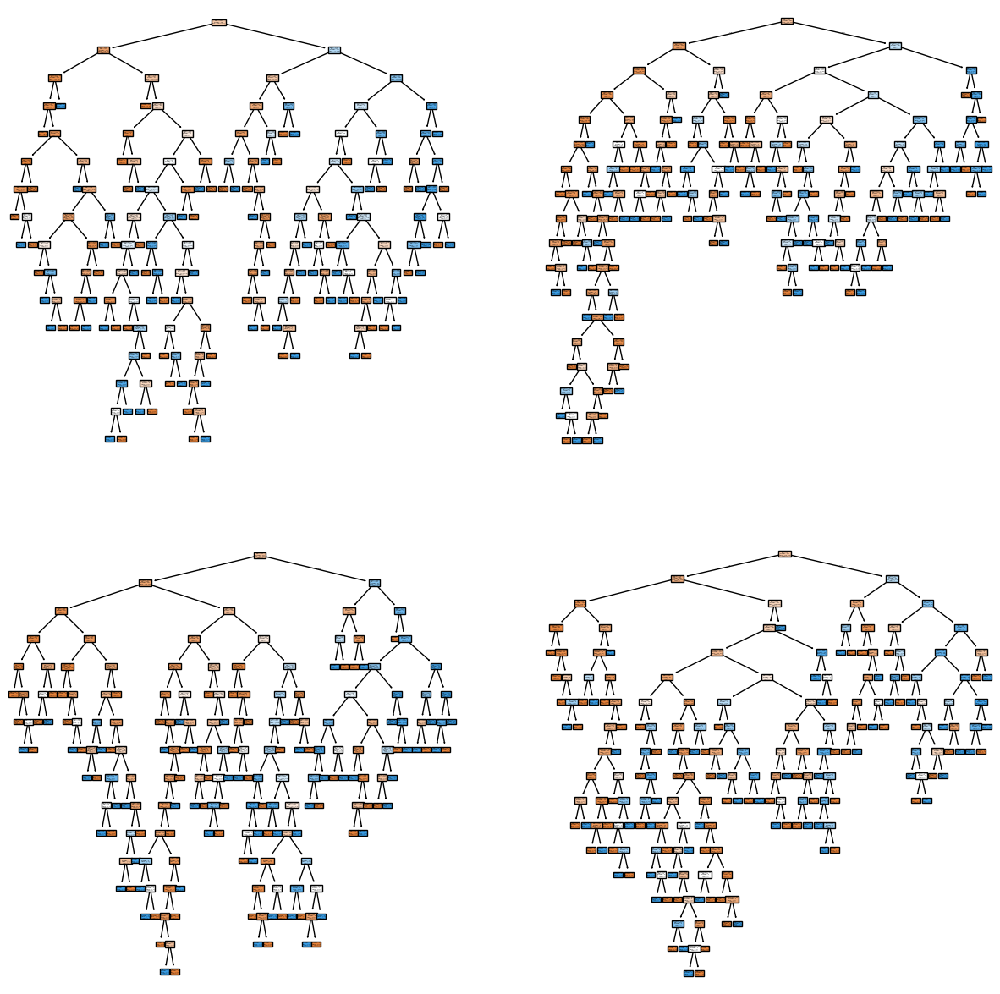

In [19]:
from sklearn import tree

fig, axis = plt.subplots(2, 2, figsize = (15, 15))

# We show the first 4 trees out of the 100 generated (default)
tree.plot_tree(model.estimators_[0], ax = axis[0, 0], feature_names = list(TRAIN_DATASETS[best_dataset_index][selected_features].columns), class_names = ["0", "1", "2"], filled = True)
tree.plot_tree(model.estimators_[1], ax = axis[0, 1], feature_names = list(TRAIN_DATASETS[best_dataset_index][selected_features].columns), class_names = ["0", "1", "2"], filled = True)
tree.plot_tree(model.estimators_[2], ax = axis[1, 0], feature_names = list(TRAIN_DATASETS[best_dataset_index][selected_features].columns), class_names = ["0", "1", "2"], filled = True)
tree.plot_tree(model.estimators_[3], ax = axis[1, 1], feature_names = list(TRAIN_DATASETS[best_dataset_index][selected_features].columns), class_names = ["0", "1", "2"], filled = True)

plt.show()

In [20]:

# Iniciar el tiempo de ejecución
start_time = time.time()

# Definir el modelo
model = RandomForestClassifier(random_state=95)

# Definir el grid de hiperparámetros
param_grid = {
    'n_estimators': [100, 200, 500],  # Número de árboles en el bosque
    'max_depth': [2, 10],  # Profundidad máxima de los árboles
    'min_samples_split': [2, 10, 20],  # Mínimo número de muestras para dividir un nodo
    'min_samples_leaf': [2, 5, 10],  # Mínimo número de muestras en una hoja
    'max_features': ['sqrt'],  # Número máximo de características a considerar
    'criterion': ['entropy'],  # Criterio de división
    'class_weight': ['balanced', None],  # Manejo de clases desbalanceadas
    'max_leaf_nodes': [None, 2, 5, 10],  # Número máximo de nodos hoja
    'min_impurity_decrease': [0.0, 0.01, 0.001],  # Reducción mínima de la impureza
    'ccp_alpha': [0.0, 0.01],  # Parámetro para poda
}

# Recorremos todos los datasets para aplicar GridSearchCV
for index, dataset in enumerate(tqdm(TRAIN_DATASETS, desc="Procesando Datasets", unit="dataset")):
    print(f"Procesando dataset {index + 1}")

    # Selección de características usando SelectKBest
    k = 6  # Número de características a seleccionar
    selector = SelectKBest(f_classif, k=k)
    X_train = selector.fit_transform(dataset, y_train)
    X_test = selector.transform(TEST_DATASETS[index])

    # Configurar GridSearchCV con validación cruzada estratificada
    grid = GridSearchCV(
        model,
        param_grid=param_grid,
        cv=StratifiedKFold(n_splits=10, shuffle=True, random_state=95),  # Validación cruzada estratificada
        n_jobs=-1,  # Utilizar todos los núcleos disponibles
        verbose=3,  # Nivel de verbosidad
        scoring='accuracy',  # Evaluar en función de la precisión
        refit=True,  # Reentrenar el modelo con los mejores parámetros encontrados
        return_train_score=True  # Para obtener las puntuaciones de entrenamiento también
    )

    # Ajustar el modelo con el conjunto de entrenamiento filtrado
    grid.fit(X_train, y_train)
    final_model = grid.best_estimator_

    # Predicciones en los datos de entrenamiento y prueba
    y_pred_train = final_model.predict(X_train)
    y_pred_test = final_model.predict(X_test)

    # Tiempo de ejecución
    end_time = time.time()
    execution_time = end_time - start_time

    # Guardar resultados
    data_to_save = {
        "hyperparams": grid.best_params_,
        "train_accuracy": accuracy_score(y_train, y_pred_train),
        "test_accuracy": accuracy_score(y_test, y_pred_test),
        "train_predictions": y_pred_train.tolist(),
        "test_predictions": y_pred_test.tolist(),
    }

    # Guardar los resultados en un archivo JSON para cada dataset
    with open(os.path.join(f"../models/hyperparams_{TRAIN_PATHS[index].split('.')[0]}.json"), "w") as json_file:
        json.dump(data_to_save, json_file, indent=4)

    print(f"Tiempo de ejecución para el dataset {index + 1}: {execution_time / 60:.4f} minutos")
    print(f"Training Accuracy: {accuracy_score(y_train, y_pred_train) * 100:.4f}")
    print(f"Test Accuracy: {accuracy_score(y_test, y_pred_test) * 100:.4f}")


Procesando Datasets:   0%|          | 0/3 [00:00<?, ?dataset/s]

Procesando dataset 1
Fitting 10 folds for each of 2592 candidates, totalling 25920 fits
[CV 7/10] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=2, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, n_estimators=100;, score=(train=0.785, test=0.721) total time=   0.1s
[CV 4/10] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=2, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, n_estimators=100;, score=(train=0.761, test=0.790) total time=   0.1s
[CV 1/10] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=2, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, n_estimators=100;, score=(train=0.788, test=0.823) total time=   0.1s
[CV 3/10] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=2, max_features=sqrt, max_leaf_nodes=None, mi

Procesando Datasets:  33%|███▎      | 1/3 [17:10<34:21, 1030.81s/dataset]

Tiempo de ejecución para el dataset 1: 17.1802 minutos
Training Accuracy: 82.2476
Test Accuracy: 79.2208
Procesando dataset 2
Fitting 10 folds for each of 2592 candidates, totalling 25920 fits
[CV 5/10] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=2, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, n_estimators=100;, score=(train=0.774, test=0.754) total time=   0.1s
[CV 1/10] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=2, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, n_estimators=100;, score=(train=0.788, test=0.823) total time=   0.2s
[CV 8/10] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=2, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, n_estimators=100;, score=(train=0.781, test=0.820) total time=   0.1s
[CV 2/10] END ccp_alp

Procesando Datasets:  67%|██████▋   | 2/3 [36:16<18:18, 1098.52s/dataset]

Tiempo de ejecución para el dataset 2: 36.2788 minutos
Training Accuracy: 81.9218
Test Accuracy: 79.8701
Procesando dataset 3
Fitting 10 folds for each of 2592 candidates, totalling 25920 fits
[CV 6/10] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=2, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, n_estimators=100;, score=(train=0.776, test=0.803) total time=   0.1s
[CV 8/10] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=2, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, n_estimators=100;, score=(train=0.779, test=0.754) total time=   0.1s
[CV 4/10] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=2, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, n_estimators=100;, score=(train=0.772, test=0.790) total time=   0.1s
[CV 2/10] END ccp_alp

/home/vscode/.local/lib/python3.11/site-packages/sklearn/feature_selection/_univariate_selection.py:783: UserWarning: k=6 is greater than n_features=4. All the features will be returned.
  warnings.warn(


[CV 9/10] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=2, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, n_estimators=100;, score=(train=0.778, test=0.721) total time=   0.1s
[CV 10/10] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=2, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, n_estimators=100;, score=(train=0.785, test=0.689) total time=   0.1s
[CV 1/10] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=2, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, n_estimators=200;, score=(train=0.777, test=0.758) total time=   0.2s
[CV 5/10] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=2, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, n_estimators=200;, sc

Procesando Datasets: 100%|██████████| 3/3 [54:46<00:00, 1095.47s/dataset]

Tiempo de ejecución para el dataset 3: 54.7736 minutos
Training Accuracy: 95.2769
Test Accuracy: 79.8701


In [21]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix

acc = accuracy_score(y_test, y_pred_test)
prec = precision_score(y_test, y_pred_test, average = 'weighted')
rec = recall_score(y_test, y_pred_test, average = 'weighted')
f1 = f1_score(y_test, y_pred_test, average = 'weighted')
cm = confusion_matrix(y_test, y_pred_test)
print("Accuracy:", acc)
print("Precision:", prec)
print("Recall:", rec)
print("F1 Score:", f1)
print("Confusion Matrix:\n", cm)

Accuracy: 0.7987012987012987
Precision: 0.7956533262655712
Recall: 0.7987012987012987
F1 Score: 0.7962702701040376
Confusion Matrix:
 [[87 13]
 [18 36]]


In [22]:
import pickle

# Guardamos el modelo en un archivo con pickle
with open("../models/decision_tree_regressor_default_95.sav", "wb") as file:
    pickle.dump(model, file)